<a href="https://colab.research.google.com/github/gurjindertoor/doggo_image_classifier/blob/main/final_end_to_end_dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# End-to-end Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow and TensorFlow Hub.

## 1. Problem

Identifying the breed of a dog given an image of a dog.

When passing dog breeds in public and you want to know the breed, this model can help.

## 2. Data

The data comes from Kaggle's dog breed identification competition:

https://www.kaggle.com/c/dog-breed-identification/data

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image:

https://www.kaggle.com/competitions/dog-breed-identification/overview

##. Features

Some information about the data:
* We're dealing with images (unstructured data) so it's best to use deep learning/transfer learning
* There are 120 breeds of dogs meaning there will be 120 different classes
* There are around 10,000+ images in the training set (these have labels)
* There are around 10,000+ images in the test set (these images have no labels because we want to be able to predict them)

In [ ]:
# Mount Drive to Google Colab

# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
# Unzip Content and Save to Directory
# !unzip '/content/drive/MyDrive/Dog2/dog-breed-identification.zip' -d '/content/drive/MyDrive/Dog2'

In [ ]:
# Import necessary tools

import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

TF version: 2.12.0
Hub version: 0.13.0
GPU available


In [ ]:
from keras.preprocessing.image import ImageDataGenerator

# Create an ImageDataGenerator object
datagen = ImageDataGenerator(
      rotation_range=40,         # Random rotation between 0 and 40 degrees
      width_shift_range=0.2,     # Randomly shift the image horizontally by up to 20%
      height_shift_range=0.2,    # Randomly shift the image vertically by up to 20%
      shear_range=0.2,           # Randomly shear the image by up to 20%
      zoom_range=0.2,            # Randomly zoom the image by up to 20%
      horizontal_flip=True,      # Randomly flip the image horizontally
      fill_mode='nearest'        # Fill any empty pixels with the nearest value
)

## Getting our data ready (turning into Tensors)

With all machine learning models, our data has to be in numerical format. That's what we'll be doing first (numerical representations).

We start by accessing our data and checking out the labels.

In [ ]:
# Checkout labels of data

import pandas as pd
labels_csv = pd.read_csv('/content/drive/MyDrive/Dog2/labels.csv')
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


<Axes: >

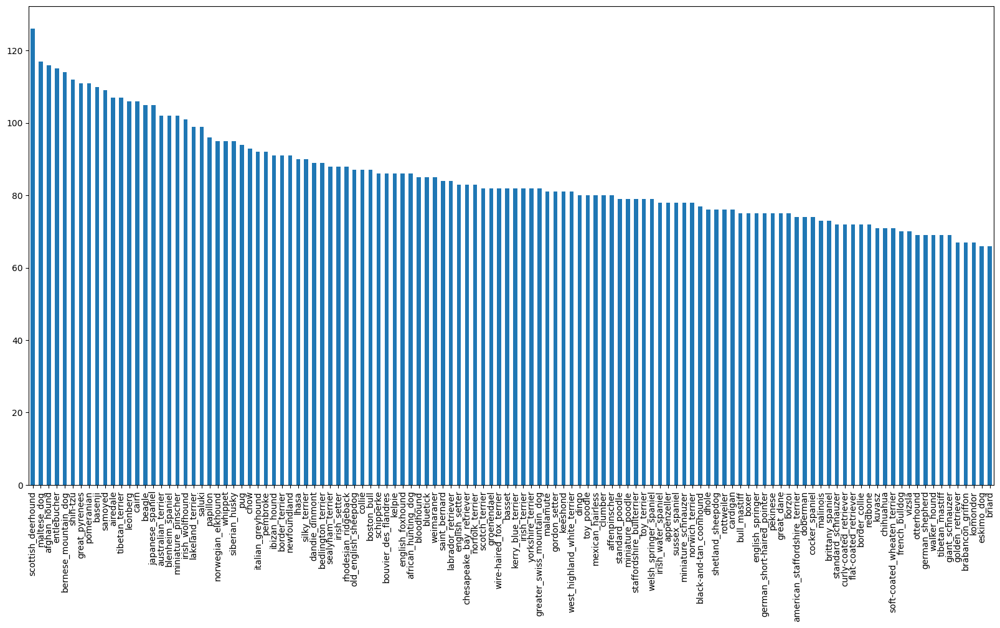

In [ ]:
# How many images are there of each breed?
labels_csv['breed'].value_counts().plot.bar(figsize=(20,10))

In [ ]:
labels_csv['breed'].value_counts().median()

82.0

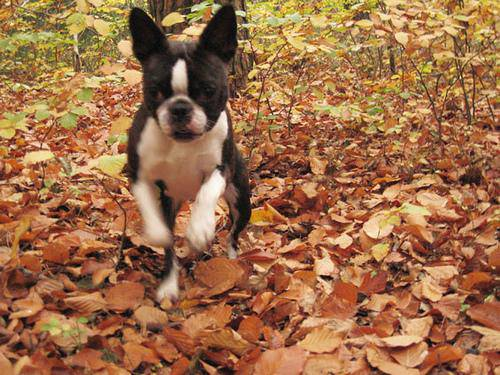

In [ ]:
# Viewing an image

from IPython.display import Image
Image('/content/drive/MyDrive/Dog2/train/000bec180eb18c7604dcecc8fe0dba07.jpg')

### Getting images and their labels

Getting a list of all of the images and their pathnames

In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
# Create pathnames from image ID's
filenames = ["drive/MyDrive/Dog2/train/" + fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10 filenames
filenames[:10]

['drive/MyDrive/Dog2/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog2/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog2/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog2/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog2/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog2/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog2/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog2/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog2/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog2/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
# Check length of filenames to verify it matches number of actual image files
import os 

if len(os.listdir('/content/drive/MyDrive/Dog2/train')) == len(filenames):
  print('Actual images and filenames match')

else:
  print('Actual images and filenames DO NOT match')

print(f'Files in folder: {len(os.listdir("/content/drive/MyDrive/Dog2/train"))}')
print(f'Files in filenames variable: {len(filenames)}')

Actual images and filenames DO NOT match
Files in folder: 10223
Files in filenames variable: 10222


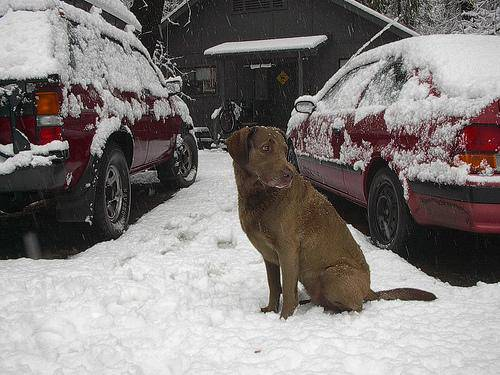

In [ ]:
Image(filenames[10221])

In [ ]:
labels_csv['breed'][10221]

'chesapeake_bay_retriever'

Since we've now got our training image filepaths in a list, it's time to prepare our labels

In [ ]:
import numpy as np

labels = labels_csv['breed'].to_numpy()
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
# See if number of labels matches the number of filenames

if len(labels) == len(filenames):
  print('Number of labels matches number of filenames')
else:
  print('Number of labels DO NOT match number of filenames')

Number of labels matches number of filenames


In [ ]:
# Finding unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
# Turn a single label into an array of booleans

print(labels[0])
labels[0 ]== unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into a boolean array

boolean_labels = [label == unique_breeds for label in labels]

len(boolean_labels)

10222

In [ ]:
# Example: turning boolean array into integers

# original label
print(labels[0])

# index where label occurs
print(np.where(unique_breeds == labels[0]))

# index where label occurs in boolean array
print(boolean_labels[0].argmax())

# there will be a 1 where the sample label occurs
print(boolean_labels[0].astype(int))

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set

In [ ]:
# Setup X and y variables
X = filenames
y = boolean_labels

len(X), len(y)

(10222, 10222)

Going to start off experimenting with ~1000 images and increase as needed

In [ ]:
# Set number of images to use for experimenting

NUM_IMAGES = 1000 #@param {type:'slider', min:1000, max:10000, step:1000}

In [ ]:
# Split data into train and validation sets

from sklearn.model_selection import train_test_split

# Split into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
# Viewing training data

X_train[:5], y_train[:2]

(['drive/MyDrive/Dog2/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog2/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/MyDrive/Dog2/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/MyDrive/Dog2/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/MyDrive/Dog2/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, 

## Prepocessing Images (turning images into Tensors/Matrix)

To preprocess images into Tensors, a function is going to be used:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`
3. Turn `image` into Tensors
4. Normalize the image (convert color channel values from 0-255 to 0-1)
5. Resize `image` to shape of (224, 224)
6. Return modified image

In [ ]:
# Convert image to NumPy array

from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
# turn image into a tensor
tf.constant(image[:2])

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [ ]:
# Define image size
IMG_SIZE = 224

# 1. Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image file path and turns image into Tensor
  """
  # 2. Read in an image file
  image = tf.io.read_file(image_path)
  # 3. Turn jpeg image into numerical Tensor with 3 color channels: RGB
  image = tf.image.decode_jpeg(image, channels=3)
  # 4. Convert color channel values from 0-255 to 0-1 values (called normalization)
  image = tf.image.convert_image_dtype(image, tf.float32)
  # 5. Resize image to desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  # 6. Return image
  return image

## Turning data into batches

TensorFlow likes data in the form of batches (also called a mini batch) - this is a small portion of your data, default size is 32

Why turn data into batches?
* Let's say you're trying ot process 10,000+ images in one go, they may not fit into memory
* A batch of 32 will be processed in the first loop iteration and every iteration after that another 32 and so on

In order to use TensorFlow effectively, the data will be in the form of Tensor tuples which look like this: `(image, label)`

In [ ]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label, then process the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)

  return image, label

In [ ]:
# Demo of the above
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now that we've got a way to turn the data into tuples of Tensors in the form: `(image, label`, the next step is to write a function that turns all of the data (X, y) into batches

In [ ]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels
    
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

The above size is in:
1. None, 224, 224, 3
  * None is for batch size because batch size is flexible, 224: height, 224: width, 3: color channel
2. None, 120
  * None, same reason, 120 class labels/dog breeds

## Visualizing Data Batches

Now that hte data is in batches it can be hard to udnerstand/comprehend so lets visualize the data

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10,10))
  # Loop through 25 (for dispalying 25 images)
  for i in range(25):
    # Create subplots (5 row, 5 columns)
    ax = plt.subplot(5,5,i+1)
    # Display an image
    plt.imshow(images[i])
    # Add image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn grid lines off
    plt.axis('off')

In [ ]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Takes batch data set, turns into numpy iterator then 
train_images, train_labels = next(train_data.as_numpy_iterator())

In [ ]:
len(train_images), len(train_labels)

(32, 32)

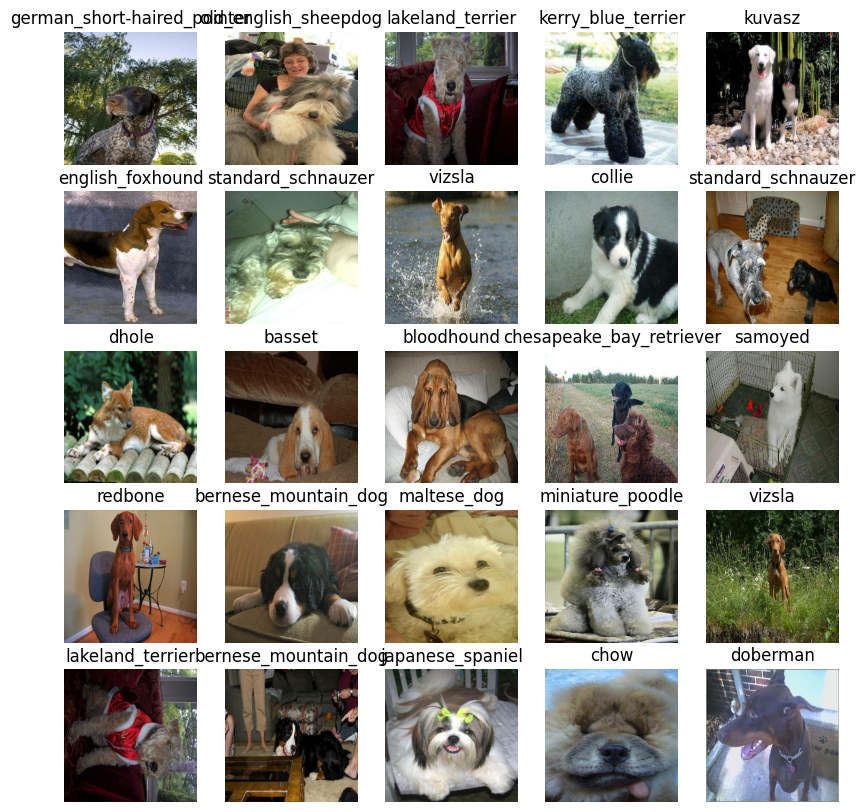

In [ ]:
# Visualizing the data in a training batch
show_25_images(train_images, train_labels)

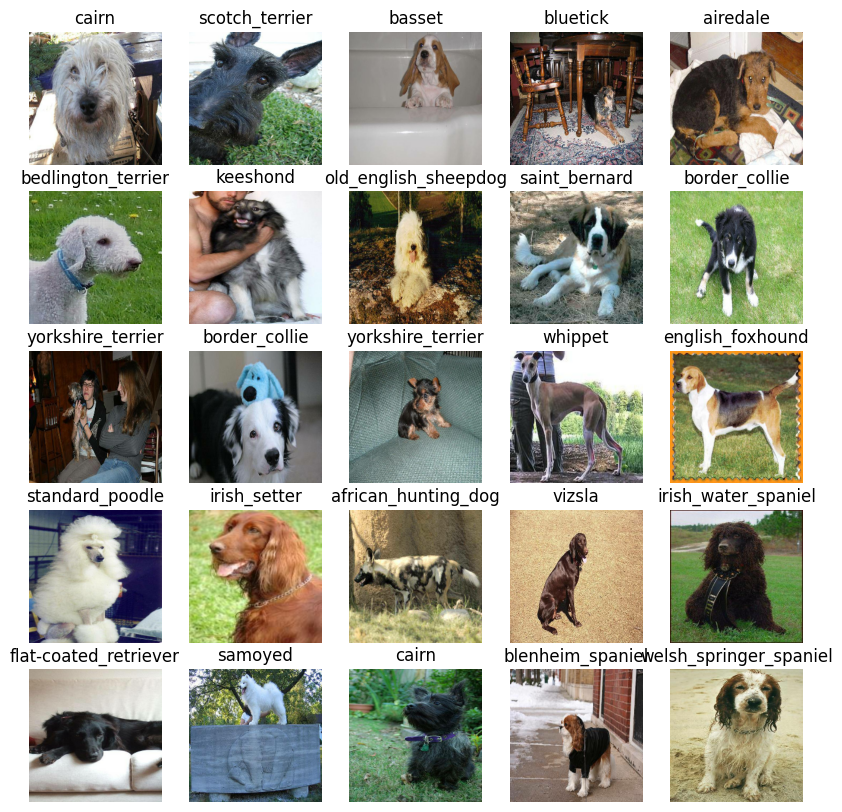

In [ ]:
# Visualizing the validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model

Before building a model, there are a few things to define:
* The input shape (our image shape in the form of Tensors) to the model
* The output shape (image labels in the form of Tensors) of the model
* The URL of the model using

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, color channels

# Setup output shape of model
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from TensorFlow Hub
# MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"
# MODEL_URL = "https://tfhub.dev/tensorflow/efficientnet/b0/classification/1"
# MODEL_URL = "https://tfhub.dev/google/imagenet/resnet_v2_101/classification/5"
MODEL_URL = "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/feature_vector/2"

Now that we have our inputs, outputs, and model ready to go it's time to put them together into a Keras deep learning model

Knowing this, let's create a function which:
* Takes input shape, output shape and model that we've chosen as parameters
* Defines the layers into a Keras model in sequential fashion (do this first, then this, then that, etc.)
* Compiles the model (says it should be evaluated and improved)
* Builds the model (tells model the input string that it'll be getting)
* Returns the model

All of the steps can be found here: https://www.tensorflow.org/guide/keras/overview

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print('Building model with:', MODEL_URL)

  # Setup the model layers
  model=tf.keras.Sequential([
      hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
      tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                            activation='softmax') # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

Layers - stack of layers that takes some input, finds patterns, returns an output

hub.KerasLayeryer, model architecture has already been implemented for us:
* Tells TensorFlow Hub to make a Keras layer of MODEL_URL layer
* Model figures out features/patterns by itself

Assigning units=OUTPUT_SHAPE:
* By default, the model we're using outputs an array of 1280, but we want ours to be the same length as the class labels

Activation='softmax':

Which activation? Which Loss?
Binary Classification:
* Activation: Sigmoid
* Loss: Binary Crossentropy

Multi-class Classification:
* Activation: Softmax
* Loss: Categorical Crossentropy



Questions to ask:
* What is a CNN

In [ ]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/feature_vector/2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              53150388  
                                                                 
 dense (Dense)               (None, 120)               153720    
                                                                 
Total params: 53,304,108
Trainable params: 153,720
Non-trainable params: 53,150,388
_________________________________________________________________


In [ ]:
outputs = np.ones(shape=(1,1,1280))
outputs

array([[[1., 1., 1., ..., 1., 1., 1.]]])

model.compile()

loss, minimize the loss - measures how well the model is learning, higher the loss the worst the model is, the lower the loss the better it's learning

optimizer, telling the model how to lower the loss, Adam is a good general optimizer that works well with most models

metrics, accuracy of how well the model is predicting the label

CAN SEARCH UP "WHAT LOSS FUNCTIONS SHOULD I USE"
* will depend on what type of problems

Params are the patterns the model has learned, base layer is the nearly 5.5m patterns that mobilenetv2 has found and we will utilize them and train our own 120k params

Baseline patterns => stick dense layer on top

## Creating callbacks

Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress, or stop training eraly if a model stops improving.

We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from training for too long.

### TensorBoard Callback

To set up a TensorBoard callback, need to do 3 things:
1. Load TensorBoard notebook extension
2. Create TensorBoard callback which saves logs to a directory and passes to model's `fit()` function
3. Visualize the models training logs with `%tensorboard` magic function (done after model training)

In [ ]:
# 1.)
# Load TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
# 2.)
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/MyDrive/Dog2/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early Stopping callback

Eearly stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [ ]:
# 3.
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience=3)

## Training a model (on a subset of data)

Our first model is only going to train on 1000 images to ensure that everything is working.

* Epochs - how many passes of the data we'd like our model to do / a pass - equivalent to the model trying to find patterns in each image to see which labels match to each image

* A training pass is one epoch would be giving a single chance to look at data and validating it, 100 epoch is 100 chances to go through data and find patterns

Each pass, images will be passed to the layers, and then as the model learns patterns, it makes guesses on which label belongs to which image, the worse off the guess is the higher the loss will be which is where Adam comes in in the optimizer which tells the model how to improve guesses with each epoch and then we see how the mdoel is doing on an accuracy level.

In [ ]:
NUM_EPOCHS = 100 #@param {type:'slider', min:10, max:100, step:10}

In [ ]:
# Check to make sure still running on a GPU
print('GPU', 'available' if tf.config.list_physical_devices('GPU') else 'not available')

GPU available


Let's create a function that trains the model.

* Create a model using `create_model()`
* Set up a TensorBoard callback using `create_tensor_board`
* Call the `fit()` function on model passing it the training data, validation data, number of epochs to train for `NUM_EPOCHS` and callbacks we'd like to use
* Return the model

In [ ]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit model to data passing it the callbacks created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping]
            )
  # validation_freq is how often we want to test the patterns that our model has foudn on our validation set, setting it to 1 means that we want to test it once per epoch

  # Return the fitted model
  return model

In [ ]:
# Fit model to data
model = train_model()

# first epoch usually takes the longest because functions written initializing into the GPU
# using more data takes longer

Building model with: https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/feature_vector/2
Epoch 1/100
25/25 [==============================] - 55s 399ms/step - loss: 4.3893 - accuracy: 0.1013 - val_loss: 3.6427 - val_accuracy: 0.2600
Epoch 2/100
25/25 [==============================] - 8s 307ms/step - loss: 2.1383 - accuracy: 0.6575 - val_loss: 2.5442 - val_accuracy: 0.5000
Epoch 3/100
25/25 [==============================] - 8s 306ms/step - loss: 0.9931 - accuracy: 0.9100 - val_loss: 1.9759 - val_accuracy: 0.5900
Epoch 4/100
25/25 [==============================] - 7s 263ms/step - loss: 0.5121 - accuracy: 0.9725 - val_loss: 1.6857 - val_accuracy: 0.6550
Epoch 5/100
25/25 [==============================] - 8s 312ms/step - loss: 0.3089 - accuracy: 0.9937 - val_loss: 1.5467 - val_accuracy: 0.6800
Epoch 6/100
25/25 [==============================] - 7s 272ms/step - loss: 0.2108 - accuracy: 0.9962 - val_loss: 1.4694 - val_accuracy: 0.6700
Epoch 7/100
25/25 [===============

Val_loss on the validation, 100% accuracy means overfitting on the training data, once val_accuracy isn't proving anymore the callback stops the epochs

100% accuracy/overfitting means it has poor ability to generalize/adapt

**Question:** Model is overfitting because performing far better on training set than validation set, what are some ways to prevent model overfitting in deep learning neural networks?

**Note:** Overfitting to begin with is a good thing! It means our model is learning!

### Checking TensorBoard logs

The TensorBoard magic function `%tensorboard` will access the logs directory we created earlier and visualize its content

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Dog2/logs 

Reusing TensorBoard on port 6006 (pid 9666), started 1:07:02 ago. (Use '!kill 9666' to kill it.)

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model

In [ ]:
# Make predictions on the validation data (not used to train on)
predictions = model.predict(val_data, verbose=1)
predictions

7/7 [==============================] - 7s 205ms/step


array([[8.8366373e-03, 1.6138167e-03, 4.8612192e-04, ..., 2.1718398e-03,
        4.4149533e-04, 1.3935117e-02],
       [8.5497182e-03, 4.0570069e-03, 3.1386553e-03, ..., 5.1582279e-03,
        2.4451429e-02, 2.5743979e-03],
       [5.5850383e-06, 5.3893996e-04, 1.4964679e-05, ..., 2.4861793e-04,
        3.8917556e-06, 2.6759383e-04],
       ...,
       [1.0188847e-04, 8.6648617e-04, 7.6009199e-04, ..., 4.1010929e-04,
        3.7501787e-04, 2.0104680e-04],
       [1.4794973e-03, 7.5049384e-04, 5.5508618e-04, ..., 2.4577105e-04,
        2.9541249e-04, 1.3095643e-02],
       [4.2356833e-04, 3.5628257e-04, 8.0560253e-04, ..., 2.3870822e-03,
        2.1527752e-03, 1.2971577e-03]], dtype=float32)

Validation batch was not used to train on, remember to think of it in terms of a test:
1. Training Set (Course Materials)
2. Validation Set (Practice Exam)
3. Test Set (Final Exam)

`model.predict()` looks at the images in val_data and makes predictions based on those images 

`verobse` is used to tell us that when the model is making predictions to tell us the current progress

In [ ]:
predictions.shape

(200, 120)

(200, 120) appears from len(y_val) = 200 images and len(unique_breeds) = 120 therefore giving the number above

In [ ]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[8.83663725e-03 1.61381671e-03 4.86121920e-04 1.94137479e-04
 7.32868444e-04 1.52847590e-03 1.88901238e-02 4.30829218e-03
 2.25212006e-03 1.29333802e-03 4.75388207e-03 7.74733140e-04
 1.70162925e-03 4.34055910e-05 5.92588622e-04 2.63431342e-04
 6.30653580e-04 5.96372746e-02 6.62829028e-04 1.60414970e-03
 6.53658388e-03 5.05674107e-04 4.41847224e-05 8.31808057e-03
 7.63049757e-05 1.35179333e-04 8.15966502e-02 1.47933478e-03
 2.20477628e-03 5.04394411e-04 4.49872576e-04 3.49106779e-03
 5.33826416e-04 3.34327924e-04 3.58955585e-04 3.31451111e-02
 3.92995309e-04 2.36024708e-03 1.61944394e-04 5.25680021e-04
 1.25517428e-03 1.40161879e-04 1.00029330e-03 1.21214020e-03
 4.01444180e-04 1.56634487e-03 3.53044190e-04 4.83954092e-04
 1.61336816e-03 3.39022314e-04 3.13326047e-04 9.69560060e-04
 1.27625791e-02 1.40813901e-03 1.18143915e-03 3.38188518e-04
 2.62545393e-04 4.67669778e-03 1.19959551e-03 5.56235090e-02
 2.17099185e-03 1.29771978e-03 6.71824557e-04 9.77159725e-05
 5.84537163e-04 4.507499

predictions[0] returns a probability value for every single label, the highest value will correspond to the index of the label that the model thinks is the most likely

Max Value/Probability of Prediction is also known as Confidence Interval, one approach is to filter based off at least .75 confidence interval

if use `np.sum(predictions[0])` this will return almost 1

`softmax` is used previously to build the model because after applying softmax, each component will be an interval of (0, 1) and the components will add up to 1 which 

all the `softmax` layer is doing is taking an array output of 1280 and changing to an array of numbers of length 120 using `softmax` activation

Having the above functionality is great but would be better to not only have it to scale but also if we could see the image the prediction is made on

In [ ]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'lhasa'

The below code is constructed to unbatch the batched `val_data` images, we want to be able to rip the data out (images, labels) of the `val_data` because the labels within are the truth labels and we want to be able to make predictions on the validation images and get the prediction labels using our function and compare the prediction labels with the actual validation labels.

TLDR: since the validation data is still in a batch dataset, we'll need to unbatchify it to make predictions on the validation images and then compare those predictions to the validation labels (truth labels)

Once unbatched, can call as numpy iterator and will turn into an interatorable list

In [ ]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've got ways to get:
* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's construct a function to visualize these.

We'll create a function which:
* Takes an array of prediction probabilities, an array of truth labels, and an array of images and integers.
* Convert the prediction probabilities to a predicted label.
* Plot the predicted label, its predicted probability, the truth label, and the image on a single plot.

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  # Get the pred label
  pred_label = get_pred_label(pred_prob)
  
  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

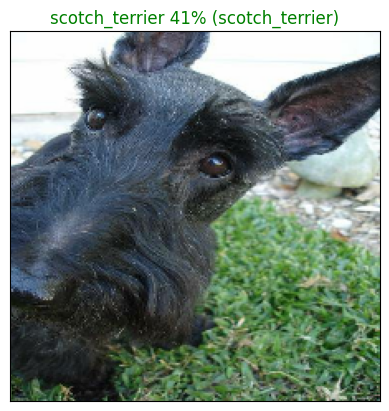

In [ ]:

# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

Now that we have one function to visualize our models top prediction, lets write another function to view our models top 10 predictions.

This function will
* Take an input of prediction probabilities array and a ground truth array and an integer
* Find the prediction using `get_pred_label()`
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probabilitie values and labels, coloring the true label green.

This is called the Top 10 Accuracy, typically we have Top 5 Accuracy of Top 10 Accuracy for models.

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

`top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]`
  * this code provides the top 10 prediction indexes and provides them in reverse


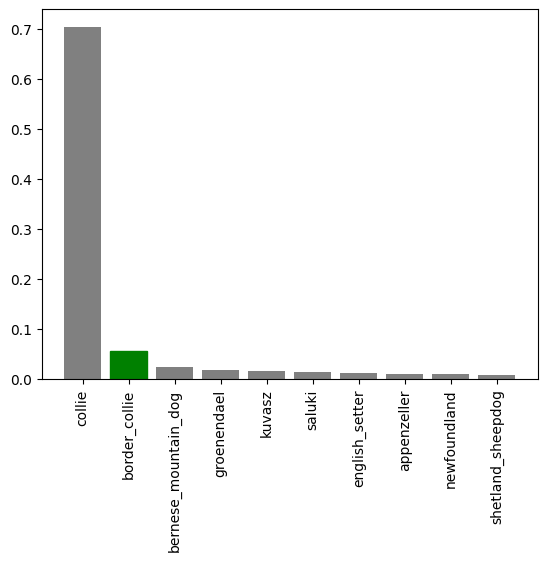

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Now that we have a function to help visualize predictions and evaluate the model, lets check out a few predictions and their different values.

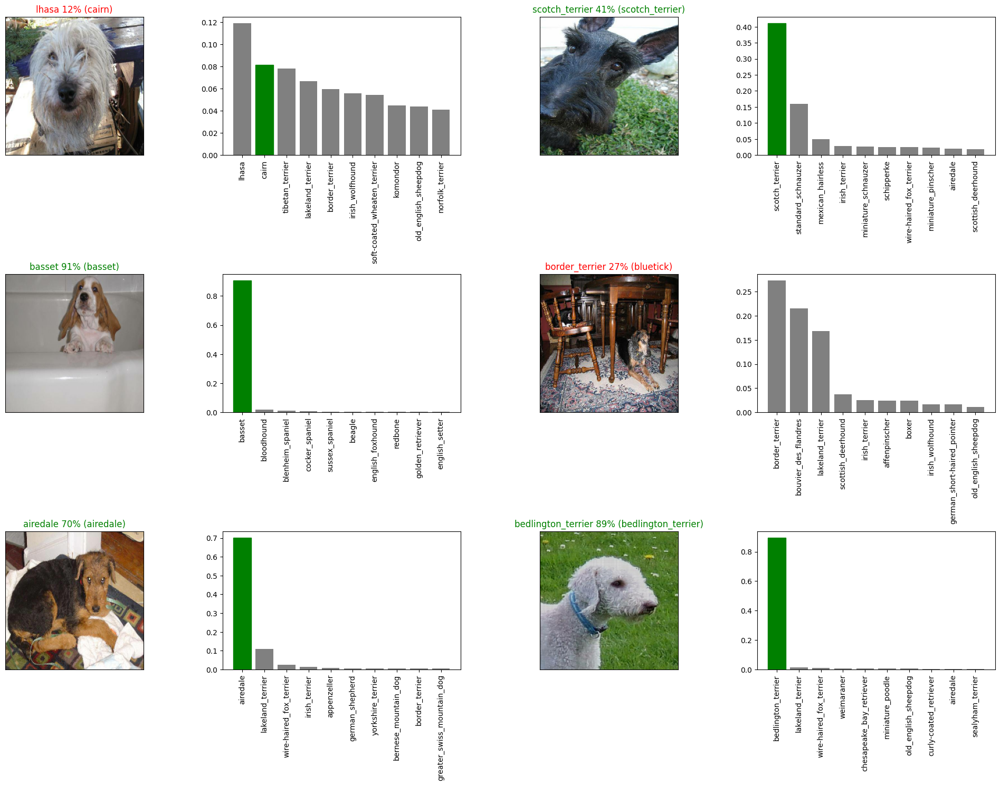

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

Should create a confusion matrix

## Saving and Loading a trained model

In [ ]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/Dog2/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
# Create a function to save a tflite model
def save_model_tflite(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/Dog2/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".tflite" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
# Create a function to save a tflite model
def save_model_tflite(model, suffix=None):
    """
    Saves a given model as a .tflite file instead of a folder,
    with an optional suffix (str) for clarity and reuse.
    """
    # Create model directory with current time
    modeldir = "drive/MyDrive/Dog2/models"
    os.makedirs(modeldir, exist_ok=True)
    model_filename = datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "-" + suffix + ".tflite"
    model_path = os.path.join(modeldir, model_filename)

    # Convert the model to TFLite format
    converter = tf.lite.TFLiteConverter.from_keras_model(model)
    tflite_model = converter.convert()

    # Save the TFLite model to the specified path
    with open(model_path, 'wb') as f:
        f.write(tflite_model)

    print(f"Saving model to: {model_path}...")
    return model_path

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="eff-net")

Saving model to: drive/MyDrive/Dog2/models/20230522-21101684789857-eff-net.h5...


'drive/MyDrive/Dog2/models/20230522-21101684789857-eff-net.h5'

In [ ]:
# Load our model trained on 1000 images
model_1000_images = load_model('drive/MyDrive/Dog2/models/20230522-20031684785816-eff-net.h5')

Loading saved model from: drive/MyDrive/Dog2/models/20230522-20031684785816-eff-net.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 185ms/step - loss: 1.3937 - accuracy: 0.6650


[1.3937321901321411, 0.6650000214576721]

In [ ]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 5s 187ms/step - loss: 1.2192 - accuracy: 0.6850


[1.219178318977356, 0.6850000023841858]

## Training model on full data

In [ ]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

In [ ]:
# Create data batch with full data set
full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Create model for full model
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/feature_vector/2


In [ ]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Dog2/logs

Reusing TensorBoard on port 6006 (pid 9666), started 1:08:02 ago. (Use '!kill 9666' to kill it.)

<IPython.core.display.Javascript object>

Running cell below will take a little while, maybe 30 min or longer for first epoch - the GPU will need to load all the images to memory

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 91s 217ms/step - loss: 1.4612 - accuracy: 0.6730
Epoch 2/100
320/320 [==============================] - 68s 213ms/step - loss: 0.4058 - accuracy: 0.8940
Epoch 3/100
320/320 [==============================] - 68s 213ms/step - loss: 0.2486 - accuracy: 0.9421
Epoch 4/100
320/320 [==============================] - 68s 212ms/step - loss: 0.1670 - accuracy: 0.9668
Epoch 5/100
320/320 [==============================] - 68s 213ms/step - loss: 0.1183 - accuracy: 0.9805
Epoch 6/100
320/320 [==============================] - 68s 212ms/step - loss: 0.0862 - accuracy: 0.9890
Epoch 7/100
320/320 [==============================] - 68s 212ms/step - loss: 0.0654 - accuracy: 0.9943
Epoch 8/100
320/320 [==============================] - 68s 213ms/step - loss: 0.0517 - accuracy: 0.9964
Epoch 9/100
320/320 [==============================] - 68s 212ms/step - loss: 0.0416 - accuracy: 0.9978
Epoch 10/100
320/320 [==============================] - 68s 211m

In [ ]:
save_model(full_model, suffix='full-image-set-eff-net')

Saving model to: drive/MyDrive/Dog2/models/20230522-21401684791601-full-image-set-eff-net.h5...


'drive/MyDrive/Dog2/models/20230522-21401684791601-full-image-set-eff-net.h5'

In [ ]:
# Create a function to save a tflite model
def save_model_tflite(model, suffix=None):
    """
    Saves a given model as a .tflite file instead of a folder,
    with an optional suffix (str) for clarity and reuse.
    """
    # Create model directory with current time
    modeldir = "drive/MyDrive/Dog2/models"
    os.makedirs(modeldir, exist_ok=True)
    model_filename = datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "-" + suffix + ".tflite"
    model_path = os.path.join(modeldir, model_filename)

    # Convert the model to TFLite format
    converter = tf.lite.TFLiteConverter.from_keras_model(model)
    tflite_model = converter.convert()

    # Save the TFLite model to the specified path
    with open(model_path, 'wb') as f:
        f.write(tflite_model)

    print(f"Saving model to: {model_path}...")
    return model_path


In [ ]:
save_model_tflite(full_model, suffix='1eff-net-tflite-model')

In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/Dog2/models/20230519-03561684468594-full-image-set-eff-net.h5')

Loading saved model from: drive/MyDrive/Dog2/models/20230519-03561684468594-full-image-set-eff-net.h5


In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/Dog2/models/20230522-20271684787261-eff-net-tflite-model.tflite')

Loading saved model from: drive/MyDrive/Dog2/models/20230522-20271684787261-eff-net-tflite-model.tflite


In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/Dog2/models/20230522-214608-1eff-net-tflite-model.tflite')

Loading saved model from: drive/MyDrive/Dog2/models/20230522-214608-1eff-net-tflite-model.tflite


OSError: ignored

## Making predictions on test dataset

Since model has been trained on images in form of Tensor batches, to make predictions on test data, we need test dataset in same format.

Luckily we created `create_data_batches()` earlier which can take a list of of filenames as input and convert them into Tensor batches

To make predictions on test data, we'll:
* Get test image filenames
* Convert filenames into test data batches using `create_date_batches()` and set the `test_data` parameter to `True` (since test data doesn't have labels).
* Make a predictions array by passing the test batches to the `predict()` method called on our model

In [ ]:
# Load test image filenames
test_path = '/content/drive/MyDrive/Dog2/test/'
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['/content/drive/MyDrive/Dog2/test/ec0ed65df0e457182b62ee172783c574.jpg',
 '/content/drive/MyDrive/Dog2/test/f0154b8ea1efd5dfb70e43fada42e56d.jpg',
 '/content/drive/MyDrive/Dog2/test/ee4c8303084840f4fa8ef6cc434dca91.jpg',
 '/content/drive/MyDrive/Dog2/test/f3ea1d71874433a4fe775deb9e95923a.jpg',
 '/content/drive/MyDrive/Dog2/test/f35539d88ab6f98c2e4d8891e1de687c.jpg',
 '/content/drive/MyDrive/Dog2/test/e8232c9a79f0e77e9b4c5fca60682d41.jpg',
 '/content/drive/MyDrive/Dog2/test/f16f47570b2ef2c21c54eb1478518e8f.jpg',
 '/content/drive/MyDrive/Dog2/test/f0fc06a2b2123325e34a2450d3202853.jpg',
 '/content/drive/MyDrive/Dog2/test/e8b49a4b2c22d3c5cb3c88c61654e991.jpg',
 '/content/drive/MyDrive/Dog2/test/f09c01de47c096fe62cd1398798c1369.jpg']

In [ ]:
len(test_filenames)

10358

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
test_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

**Note:** Calling `predict()` on full model and passing it the test data batch will take a long time to run (about an ~1hr)

In [ ]:
# make predictions on test data batch using loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 239s 703ms/step


In [ ]:
# Save predictions (NumPy array) to csv file (for access later)
np.savetxt('/content/drive/MyDrive/Dog2/preds_array.csv', test_predictions, delimiter=",")

In [ ]:
# Load predictions (NumPy array) from csv file
test_predictions = np.loadtxt('/content/drive/MyDrive/Dog2/preds_array.csv', delimiter=",")

In [ ]:
test_predictions[:10]

array([[5.23503029e-12, 4.77532922e-05, 1.11875131e-08, ...,
        9.41057806e-05, 1.65052971e-09, 2.49279957e-08],
       [2.75345860e-06, 4.16744521e-11, 3.01000398e-08, ...,
        1.19412292e-07, 6.04161582e-11, 3.10838431e-08],
       [8.21688373e-05, 1.98280947e-08, 8.79887409e-07, ...,
        3.22858682e-08, 7.98461697e-05, 1.35317342e-02],
       ...,
       [3.23426860e-07, 8.68509815e-08, 3.18674775e-09, ...,
        5.24486721e-09, 1.55917534e-09, 1.52187681e-07],
       [3.98886293e-08, 2.25333933e-05, 2.83337471e-07, ...,
        6.29752049e-06, 4.38215636e-07, 3.42705171e-08],
       [6.82624179e-09, 1.01280384e-04, 1.91677536e-05, ...,
        7.13060729e-07, 2.29948753e-07, 9.41210487e-09]])

In [ ]:
test_predictions.shape

(10358, 120)

## Preparing test data set for Kaggle

Kaggle wants our models prediction probability outputs in a DataFrame with an ID and a column for each different dog breed: https://www.kaggle.com/competitions/dog-breed-identification/overview/evaluation

To get data in format we'll:
* Create a pandas DataFrame with an ID column as well as a colum for each dog breed
* Add data to the ID column by extracting the test image ID's from their filepaths
* Add data (the prediction probabilities) to each of the dog breed columns
* Export the DataFrame as a CSV to submit it to Kaggle

In [ ]:
# Create a pandas DataFrame
preds_df = pd.DataFrame(columns=['id'] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# Append test image ID's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df['id'] = test_ids

In [ ]:
preds_df.head()

In [ ]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

In [ ]:
# Save predictions DataFrame to CSV for submission to Kaggle
preds_df.to_csv('/content/drive/MyDrive/Doggeth-Vision/full_model_predictions_submission_1_mobilenetV2.csv')

## Making predictions on custom images

To make predictions on custom images, we'll:
* Get filepaths of own images
* Turn filepaths into data batches using `create_data_batches()` and since our images won't have labels we set `test_data` parameter to `True`
* Pass custom image data batch to model's `predict()` method
* Convert prediction output probabilities to predictions labels
* Compare predicted labels to custom images

In [ ]:
# Get custom image filepaths
custom_path = '/content/drive/MyDrive/Dog2/dogs-pics/'
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
# specify the path to the directory containing .ipynb_checkpoints
dir_path = "/content/drive/MyDrive/Dog2/dogs-pics/"

# iterate over all files and directories in the directory
for filename in os.listdir(dir_path):
    # check if the filename starts with .ipynb_checkpoints
    if filename.startswith(".ipynb_checkpoints"):
        # delete the directory
        os.rmdir(os.path.join(dir_path, filename))

In [ ]:
custom_image_paths

['/content/drive/MyDrive/Dog2/dogs-pics/husky.jpg',
 '/content/drive/MyDrive/Dog2/dogs-pics/great-pyr.jpg',
 '/content/drive/MyDrive/Dog2/dogs-pics/golden-retriever.jpg',
 '/content/drive/MyDrive/Dog2/dogs-pics/blue.jpg',
 '/content/drive/MyDrive/Dog2/dogs-pics/kuv.jpg']

In [ ]:
# Turn custom images into batch datasets
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [ ]:
# Make predictions on custom data
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 2s 2s/step


In [ ]:
custom_preds.shape

(5, 120)

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['siberian_husky', 'great_pyrenees', 'golden_retriever', 'bluetick', 'kuvasz']

In [ ]:
# Get custom images (our unbatchify() function won't work) since there arne't labels (maybe fix later)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

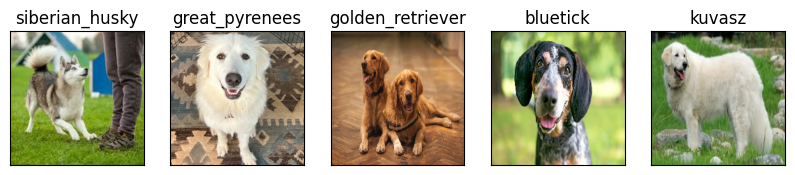

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10,10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 5, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)